# Variable Number of Gradients (VNG)

В данном ноутбуке представлен пример использования алгоритма VNG

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image

from algorithms.vng import VNG
from utils.metrics import PSNR

In [2]:
import warnings
warnings.filterwarnings("ignore")

## Подготовка изображения

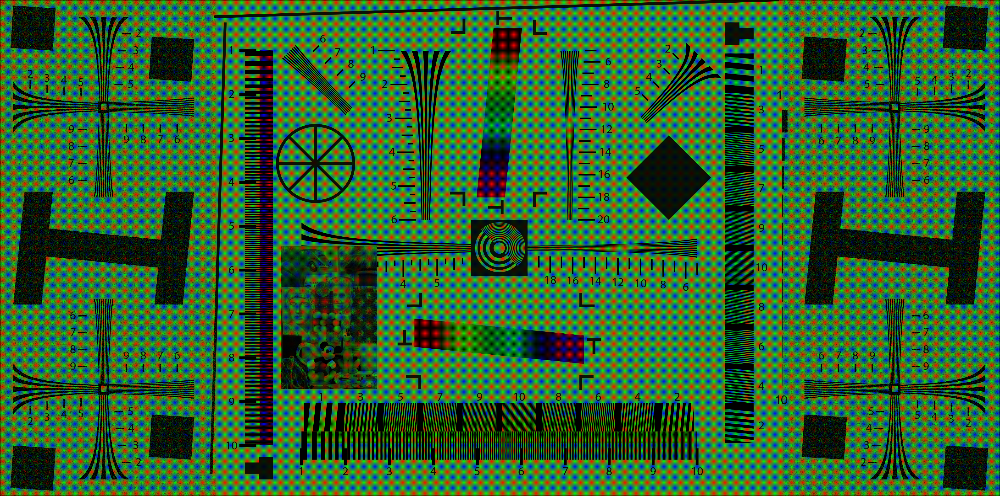

In [3]:
# Чтение изображения из файла
image = Image.open("samples/resolution_test/RGB_CFA.bmp")

# Рассмотрим изображение как массив формы (height, width, channels)
np_image = np.array(image, dtype="int64")

# Сделаем отступы, чтобы не уменьшить размер результата
np_padded_image = np.pad(np_image, ((2, 2), (2, 2), (0, 0)), mode="constant")

# Посмотрим на изображение
Image.fromarray(np_padded_image.astype("uint8"))

## Применение алгоритма

In [4]:
# Применим алгоритм к нашему изображению с отступами
# В результате получим новое изображение, интерполированное
# Для отслеживания оставшегося времени используется tqdm (показывается число обработанных строк)
np_interpolated_image = VNG().apply(np_padded_image)

100%|██████████| 2073/2073 [17:37<00:00,  1.96it/s]


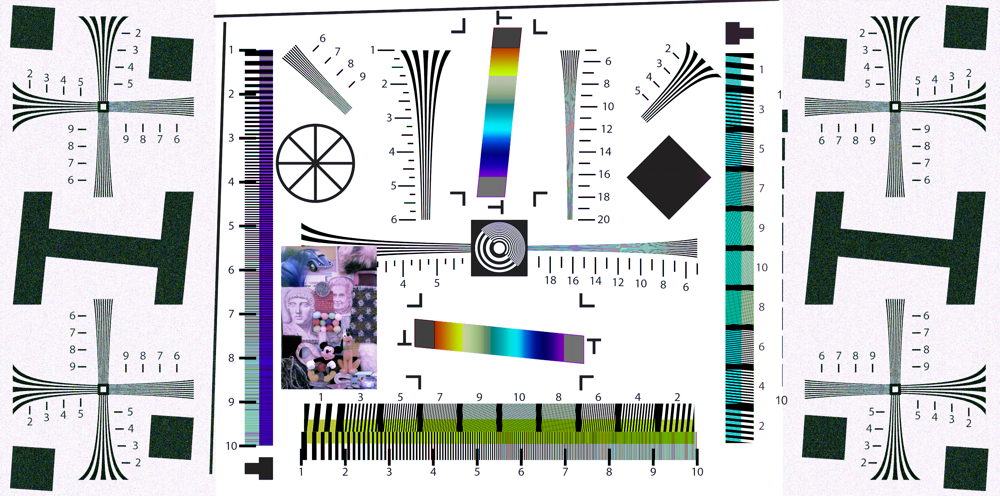

In [6]:
# Посмотрим на получившееся изображение
Image.fromarray(np_interpolated_image.astype("uint8"))

## Подсчёт метрик

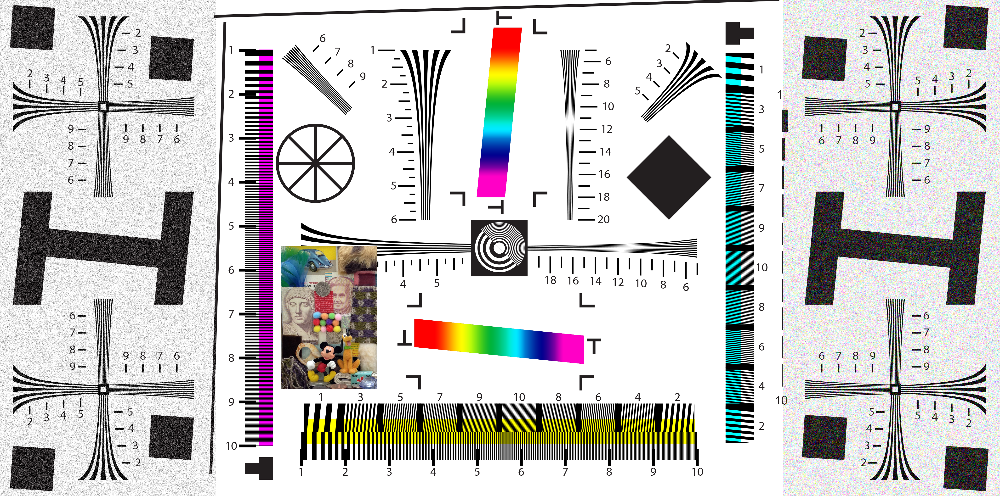

In [7]:
# Аналогичным образом загрузим оригинал изображения
original_image = Image.open("samples/resolution_test/Original.bmp")
np_original_image = np.array(original_image, dtype="int64")

# Посмотрим на изображение
Image.fromarray(np_original_image.astype("uint8"))

In [9]:
# Подсчитаем метрику PSNR
psnr_result = PSNR(np_original_image, np_interpolated_image)

print("PSNR metrics result:", psnr_result)

PSNR metrics result: 20.133213529596947


## Сохранение результата

In [20]:
# Сохраним получившееся изображение на диск
Image.fromarray(np_interpolated_image.astype("uint8")).save("samples/resolution_test/Result.bmp")

## Выводы

### Качество работы

Реализация справилась с цветами хуже, чем хотелось бы: очень не хватает красного и ярко-зелёного, но в то же время чёрные линии по бокам и в центре сохранили свою точность до деления `8`.

Метрика `PSNR` равна `20.1`. 

### Время работы

На обработку тестового изображения алгоритм потратил `17 минут 37 секунд`, то есть работал он со скоростью около `8190 пикселей в секунду`. Предполагается, что данный результат можно сильно улучшить, переписав алгоритм на условном `C++`. 